# Dataset Voli
Il dataset analizzato riguarda la rete dei voli tra gli aeroporti di tutto il mondo. I nodi (vertici) rappresentano gli aeroporti mentre gli archi rappresentano i voli tra un aeroporto ed un altro.

https://networks.skewed.de/net/openflights

In [1]:
import igraph
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

df = pd.read_csv('data/edges.csv', header=0, names=['source','target','weight','airline', 'airline_code', 'codeshare', 'equipment', 'stops'])
nodes = pd.read_csv('data/nodes.csv', skipinitialspace = True)
nodes.rename(columns = {'name':'airport_name'}, inplace = True)

EN = igraph.Graph.TupleList(df[['source','target','weight','airline']].itertuples(index=False), edge_attrs="weight",directed=True)
print(EN.summary()) 
#nodi / archi
# D = Directed , N = Vertice di nome 'name', W =  Weighted


IGRAPH DNW- 3214 66771 -- 
+ attr: name (v), weight (e)


##  Grafo della Rete

In [2]:
#, vertex_label=EN.vs[" IATA/FAA"]
vs_EN = {"bbox":(300,300), "margin":20}
#vs_EN['edge_width'] = [w for w in EN.es['weight']]
vs_EN['vertex_size'] = 10
vs_EN['edge_arrow_size'] = 0
igraph.plot(EN, **vs_EN)

## Caricamento degli attributi
La funzione read_node_attributes associa ad ogni Vertice del grafo, i corrispodenti attributi presenti nel dataframe nodes. In questo modo possiamo visualizzare la label più adatta al nostro caso di studio.


In [3]:
#vs (vertici/nodi)
#es (edge)
def read_node_attributes(vs):
    for e in vs:
        a = nodes.loc[nodes['# index']==e['name']]
        if len(a)>0:
             for column in nodes:
                e[column] = a[column].iloc[0]

        
read_node_attributes(EN.vs)

# Basic Topological properties

## Vertex, edges, attributes

In [40]:
# the number of vertices and edges can be directly obtained like this:
print('number of vertices in G:', EN.vcount())
print('number of edges in G:', EN.ecount())

# list of vertex and edge attributed (if any):
print('G has the following vertex attributes:', EN.vertex_attributes())
print('G has the following edge attributes:', EN.edge_attributes())


number of vertices in G: 3214
number of edges in G: 66771
G has the following vertex attributes: ['name', '# index', 'id', 'airport_name', 'city', 'country', 'IATA/FAA', 'ICAO', 'latitude', 'longitude', 'altitude', 'timezone', 'DST', '_pos']
G has the following edge attributes: ['weight']


## Network Diameter and Average Path lenght

In [56]:
#Presi due nodi il diametri rappresenta il numero di passaggi (archi) da percorrere per arrivare a destinazione
print('the diameter of EN is:', EN.diameter())
diameter_path = EN.get_diameter()
node1 = diameter_path[0]
node2 = diameter_path[13]
print(str(node1)+ " "+str(node2))
print(EN.vs[node1]['airport_name'],EN.vs[node1]['ICAO'],' - >',EN.vs[node2]['airport_name'],EN.vs[node2]['ICAO'])

# computing the diameter of FW may take some time...
# print('the diameter of FW is:', FW.diameter())
vertex=EN.vs.select( ICAO='LIRA')[0]

print('the eccentricity of node 1 in EN is:', EN.eccentricity(vertex.index))
print('the average distance in EN is:', EN.average_path_length())
print('what do you think of these values with respect to the graph size?')

#for a in EN.vs:
#    print(str(a.index) + " "+  a['airport_name'])

the diameter of EN is: 13
3121 1045
Peawanuck Airport CYPO  - > Matari Airport FZJH
the eccentricity of node 1 in EN is: 8.0
the average distance in EN is: 3.9859526109992083
what do you think of these values with respect to the graph size?


## Percorso massimo tra Peawnuck Airport e Matari Airport

[[1045, 1037, 560, 439, 254, 90, 185, 208, 206, 207, 3122, 3120, 3121]]


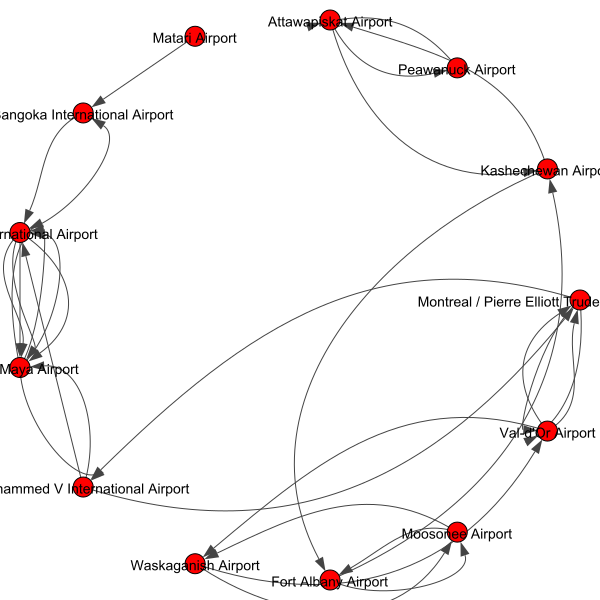

In [67]:
# Identifica gli indici dei nodi di interesse
start_node_index = 1045  # Indice del primo nodo del percorso
end_node_index = 3121  # Indice del secondo nodo del percorso


# Ottieni il percorso più breve tra i due nodi
shortest_path = EN.get_shortest_paths(start_node_index, to=end_node_index, mode='OUT', weights=EN.es['weight'])
print(shortest_path)
# Crea un sottografo con i nodi e gli archi dello shortest path

subgraph_edges = [(shortest_path[i], shortest_path[i+1]) for i in range(len(shortest_path)-1)]  # Crea gli archi

# Crea un oggetto Graph per il sottografo
subgraph = EN.subgraph(subgraph_nodes)
read_node_attributes(subgraph.vs)        
# Imposta gli attributi dei nodi per il disegno
node_colors = ["red" if node in subgraph_nodes else "blue" for node in subgraph.vs.indices]
node_sizes = [20 if node in subgraph_nodes else 10 for node in subgraph.vs.indices]

ig.plot(subgraph, **visual_style,vertex_label= subgraph.vs['airport_name'],layout=subgraph.layout("circle"))


## Isolation

In [6]:
# Get the degrees of all vertices
degrees = EN.degree()

# Get the isolated vertices (vertices with degree 0)
isolates = [v.index for v in EN.vs if degrees[v.index] == 0]
# Print the isolated vertex indices
print("Isolated vertices:", isolates)

Isolated vertices: []


## Subplot by distance between Airport
Subplot grafo, relativo a nodi con una distanza prefissata

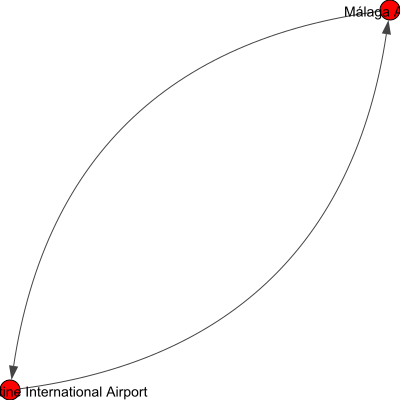

In [7]:
distance = 1575.7077404359388
visual_style = {"bbox":(400,400), "margin":10}
KA = EN.subgraph_edges([e for e in EN.es if e['weight']==distance])
read_node_attributes(KA.vs)        

#vs (vertici/nodi)
#es (edge)

igraph.plot(KA, **visual_style ,vertex_label= KA.vs['airport_name'],delete_vertices=False)
#LIRA (Ciampino) - LEMG Malaga

## Subgrafo dei voli dell'Aeroporto di Ciampino

100


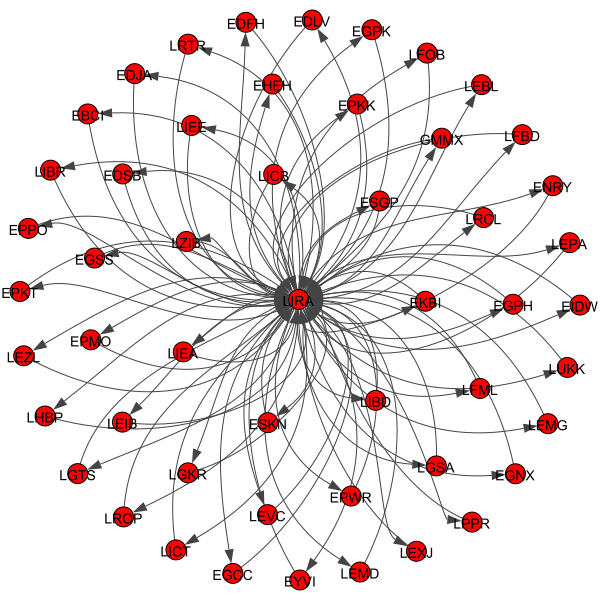

In [53]:
import igraph as ig

# Trova l'indice del nodo con il codice aeroportuale "LIRA"
vertex_index = EN.vs.find(ICAO='LIRA').index

# Filtra gli archi che contengono il nodo con l'indice trovato
edge_indices = [e.index for e in EN.es if vertex_index in (e.source, e.target)]

# Crea un nuovo sottografo con gli archi filtrati
KA = EN.subgraph_edges(edge_indices)
print(len(edge_indices))
# Visualizza il nuovo sottografo
visual_style = {"bbox": (600, 600), "margin": 20}
#visual_style['edge_arrow_size'] = 0.0001
ig.plot(KA, **visual_style, vertex_label=KA.vs['ICAO'])


## Elenco Voli in partenza da un aeroporto

In [9]:
#Esempio voli che Partono da Ciampino
vertex=EN.vs.select( ICAO='LIRA')[0]
vs=vertex.successors() 
#Utilizzando predecessors, possiamo ottenere i voli hanno come destinazione ciampino
print(len(vs))

ordered = np.sort([u["airport_name"] +" - "+ u['ICAO']+ " - "+ str(EN.es[u['# index']]['weight']) for u in vs ])
print(ordered)


50
['Adolfo Suárez Madrid–Barajas Airport - LEMD - 661.8733331376623'
 'Alghero-Fertilia Airport - LIEA - 233.04338669657605'
 'Barcelona International Airport - LEBL - 135.89787455598474'
 'Bari Karol Wojtyła Airport - LIBD - 350.7241883215378'
 'Billund Airport - EKBI - 1019.3435584408224'
 'Bordeaux-Mérignac Airport - LFBD - 586.2186580942607'
 'Brindisi – Salento Airport - LIBR - 326.43062212266653'
 'Brussels South Charleroi Airport - EBCI - 172.47179067267368'
 'Budapest Liszt Ferenc International Airport - LHBP - 1107.2328693783147'
 'Cagliari Elmas Airport - LIEE - 492.6209286304485'
 'Chania International Airport - LGSA - 123.1043633775482'
 'Chişinău International Airport - LUKK - 1201.029385909757'
 'Cluj-Napoca International Airport - LRCL - 3683.3001296020393'
 'Comiso Airport - LICB - 5350.430970849717'
 'Copernicus Wrocław Airport - EPWR - 950.6926278681764'
 'Dublin Airport - EIDW - 1187.215591812757'
 'East Midlands Airport - EGNX - 401.1486358743191'
 'Edinburgh Airpo

## Connected Components

In [10]:
# check if the graph is connected
print('is G graph connected?', EN.is_connected())



is G graph connected? False


## Giant Component

In [11]:
components = EN.components()

# Ottieni il componente gigante
giant_component = components.giant()

# Calcola la dimensione del componente gigante
giant_component_size = giant_component.vcount()
print(giant_component_size)

3147


## Degree
Somma degli archi entranti ed uscenti del nodo che si sta considerando

In [12]:
print('the average degree of EN is:', np.mean(EN.degree()))
print('the max degree of EN is:', np.max(EN.degree()))
print('the density of EN is:', EN.density())
print(' argmax', np.argmax(EN.degree()))
print(EN.vs[np.argmax(EN.degree())])


the average degree of EN is: 41.550093341630365
the max degree of EN is: 1826
the density of EN is: 0.006465934226833235
 argmax 251
igraph.Vertex(<igraph.Graph object at 0x000001484448EA40>, 251, {'name': 1809, '# index': 1809, 'id': 3682, 'airport_name': 'Hartsfield Jackson Atlanta International Airport', 'city': 'Atlanta', 'country': 'United States', 'IATA/FAA': 'ATL', 'ICAO': 'KATL', 'latitude': 33.6367, 'longitude': -84.428101, 'altitude': 1026, 'timezone': -5.0, 'DST': 'A', '_pos': 'array([6.0545693 , 1.09704578])'})


this is the degree distribution of EN:
it is not easy to see the distribution because of the difference in the counts


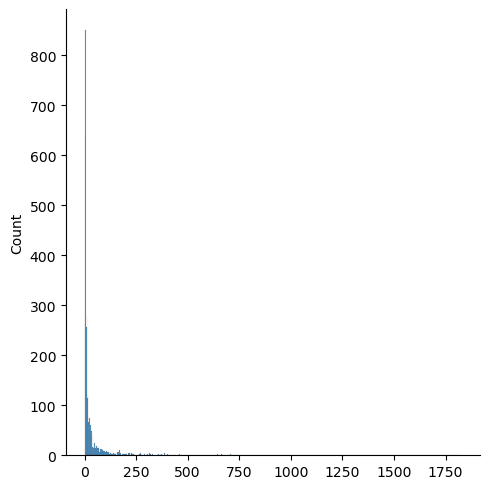

In [13]:
# seaborn is a nice plotting library built on top of the famous matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

print('this is the degree distribution of EN:')
# displot plots distributions from just the list of values
sns.displot(EN.degree())

print('it is not easy to see the distribution because of the difference in the counts')

## Pagerank Centrality

In [14]:
print('the EN graph with node size proportional to PageRank:')
vs_EN = {"bbox":(400,400), "margin":20}
vs_EN['vertex_size'] = [150*x for x in EN.pagerank()]

vs_EN['edge_arrow_size'] = 0
igraph.plot(EN, **vs_EN)

the EN graph with node size proportional to PageRank:


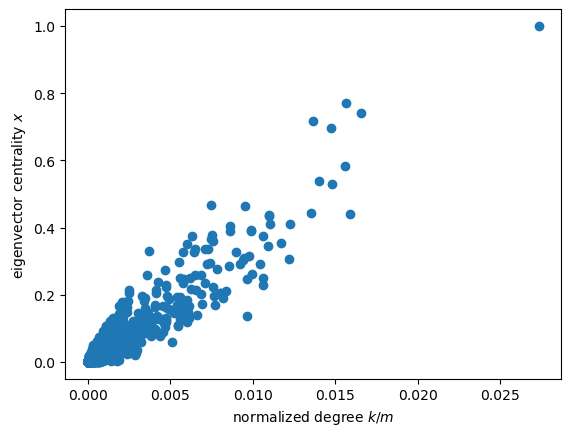

the eigenvector centrality is generally correlated with the degree
in EN, the Pearson correlation coefficient between x and k/m is 0.945


In [15]:


normalized_degree = [d/EN.ecount() for d in EN.degree()]
ec = EN.eigenvector_centrality()
rho = pearsonr(ec,normalized_degree)[0]

ax = plt.scatter(normalized_degree, ec)
plt.xlabel('normalized degree $k/m$')
plt.ylabel('eigenvector centrality $x$')
plt.show()
print('the eigenvector centrality is generally correlated with the degree')
print(f'in EN, the Pearson correlation coefficient between x and k/m is {round(rho,3)}')

# Geometric centralities

## Closeness and Harmonic centrality

In [16]:
normalized_degree = [d/EN.ecount() for d in EN.degree()]
print('the EN graph with node size proportional to closeness (left) and harmonic centrality (right):')
fig = plt.figure(figsize=(10,4))
ax = fig.subplots(nrows=1, ncols=2)
vs_EN_cl = {"bbox":(300,300), "margin":20}
vs_EN_cl['vertex_size'] = [15*x for x in EN.closeness()]
vs_EN_cl['edge_arrow_size'] = 0
igraph.plot(EN, **vs_EN_cl, target=ax[0])
vs_EN_hc = {"bbox":(300,300), "margin":20}
vs_EN_hc['vertex_size'] = [15*x for x in EN.harmonic_centrality()]
vs_EN_hc['edge_arrow_size'] = 0
igraph.plot(EN, **vs_EN_hc, target=ax[1])
plt.show()


the EN graph with node size proportional to closeness (left) and harmonic centrality (right):


KeyboardInterrupt: 

## Pagerank, betweenness, harmonic

Il "PageRank" è un algoritmo utilizzato nell'analisi delle reti per valutare l'importanza dei nodi in un grafo direzionato. È stato sviluppato dai fondatori di Google, Larry Page e Sergey Brin, per valutare la rilevanza delle pagine web nel motore di ricerca di Google.

La "harmonic centrality" (centralità armonica) è una misura di centralità utilizzata nell'analisi delle reti per valutare l'importanza di un nodo in base alla sua capacità di comunicazione o influenza all'interno della rete. Questa misura tiene conto della somma delle reciproche delle distanze più brevi tra un nodo e tutti gli altri nodi della rete.

La "betweenness centrality" (centralità di intermediazione) è una misura di centralità utilizzata nell'analisi delle reti per valutare l'importanza di un nodo come ponte o intermediario nella comunicazione tra altri nodi all'interno della rete.

In [ ]:

import numpy as np
normalized_degree = [d/EN.ecount() for d in EN.degree()]
pagerank = EN.pagerank()
print('a comparison of the top-10 for a few metrics for the EN graph:')
bc = EN.betweenness()
hc = EN.harmonic_centrality()
print('\nnormalized degree:')
for i in np.argsort(normalized_degree)[:-11:-1]:
    print(normalized_degree[i]," ",EN.vs[i]['airport_name']) 
arr_page_rank=np.argsort(pagerank)
print(len(arr_page_rank))
print('\nPageRank Top 10:')
for i in arr_page_rank[:-11:-1]:
    print(np.round(pagerank[i],3)," ",EN.vs[i]['airport_name']) 
    
print('\nPageRank Bottom 10:')
for i in arr_page_rank[10:20]:
    print(np.round(pagerank[i],4)," ",EN.vs[i]['airport_name']," ",EN.vs[i]['ICAO'])     

print('\nHarmonic centrality Top 10:')
for i in np.argsort(hc)[:-11:-1]:
    print(np.round(hc[i],3)," ",EN.vs[i]['airport_name']) 

print('\nHarmonic centrality Bottom 10:')
for i in np.argsort(hc)[10:20]:
    print(np.round(hc[i],3)," ",EN.vs[i]['airport_name']) 
    
print('\nBetweenness centrality Top 10:')
for i in np.argsort(bc)[:-11:-1]:
    print(np.round(bc[i]/EN.vcount()**2,3)," ",EN.vs[i]['airport_name'])
    
    
print('\nBetweenness centrality Bottom 10:')
for i in np.argsort(bc)[10:20]:
    print(np.round(bc[i]/EN.vcount()**2,3)," ",EN.vs[i]['airport_name'])

In [ ]:
print('the EN graph with node size proportional to degree (left) and betweenness centrality (right):')
fig = plt.figure(figsize=(10,4))
ax = fig.subplots(nrows=1, ncols=2)
vs_EN_d = {"bbox":(300,300), "margin":20}
vs_EN_d['vertex_size'] = [100*x for x in normalized_degree]
igraph.plot(EN, **vs_EN_d, target=ax[0])
vs_EN_bc = {"bbox":(300,300), "margin":20}
vs_EN_bc['vertex_size'] = [200*x/EN.vcount()**2 for x in bc]
igraph.plot(EN, **vs_EN_bc, target=ax[1])
plt.show()

## Transitivity

In [ ]:
print('the global clustering of EN is:')
print(EN.transitivity_undirected())

In [ ]:

EN_cl = EN.transitivity_local_undirected()

import seaborn as sns
import matplotlib.pyplot as plt
# this is a normalized histogram
ax = sns.histplot({'EN':EN_cl}, fill=False, common_norm=False, stat='probability') 
plt.grid()
plt.show()


## Assortativity

In [ ]:
print('the degree assortativity of EN is:', EN.assortativity_degree())

## Community

In [ ]:
EN_louvain = EN.community_multilevel()
EN_walktrap = EN.community_walktrap().as_clustering()
CM = igraph.Graph.Degree_Sequence(EN.degree(), method='vl')
print('the communities of the EN graph with the Louvain (modularity-based, left) and the walktrap (random-walk-based, right) algorithsm:')
fig = plt.figure(figsize=(10,4))
ax = fig.subplots(nrows=1, ncols=2)
vs = {"bbox":(300,300), "margin":20}
vs['vertex_color']=EN_louvain.membership
igraph.plot(EN, **vs, target=ax[0])
vs['vertex_color']=EN_walktrap.membership
igraph.plot(CM, **vs, target=ax[1])
plt.show()

## Random Graph

In [ ]:
n,p = 3214 ,0.2
ER = igraph.Graph.Erdos_Renyi(n,p)
vs_ER = {"bbox":(200,200), "margin":20}
vs_ER['vertex_size'] = 5
igraph.plot(ER, **vs_ER)


In [ ]:
#calcolo del coefficiente binomiale per stimare il numero di nodi della rete casuale
import math
coeff_bin=round(math.comb(n, 2) * p)
print(coeff_bin)

In [ ]:
print('the expected number of edges is', coeff_bin)
m = [igraph.Graph.Erdos_Renyi(n,p).ecount() for _ in range(1000)]

print('the empirical average number of edges is', np.mean(m))
print('the distribution of the number of edges:')
plt.hist(m)
plt.show()

In [ ]:
degree = ER.degree()
print('the empirical average degree is', np.mean(degree))
print('the degree distribution is:')
plt.hist(degree)
plt.show()